# Experiment 2

In [1]:
import os
import tqdm
import pickle
import numpy as np
import networkx as nx

import seaborn as sns
from scipy.stats import beta

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.path as mpath
import matplotlib.collections as mcoll
import matplotlib.animation as animation

from time import time
from scipy.stats import pearsonr
from mpl_toolkits.mplot3d import Axes3D 
from matplotlib.colors import LinearSegmentedColormap

from model_optimized import run_model_n_times
from experiment_utils import get_distribution,get_development_matrix,findIntersection

from plotting_utils import plot_development,plot_neighbors
from plotting_utils import plot_model_summary,plot_network_development_summary,plot_stage_distribution

___

# 1. Initialization

## 0. Seeds

In [2]:
seed_network = 42
seed_numpy = 22

In [3]:
np.random.seed(seed_numpy)

## 1. Model

In [4]:
PLOT = True

Model summary


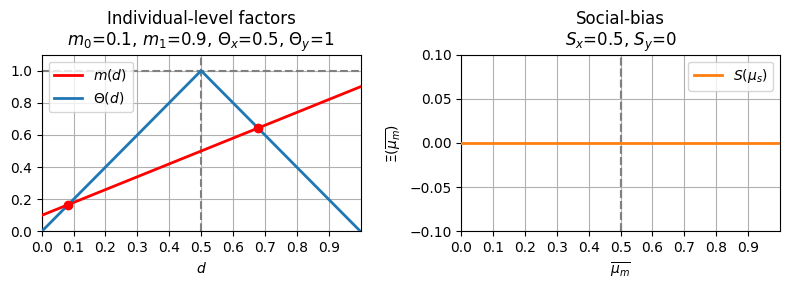

Starting network summary
Egocentric stage length: 0.08333333333333334
Ethnocentric stage length: 0.5952380952380952
Worldcentric stage length: 0.3214285714285714


In [5]:
# 1. Model definition
m0 = 0.1
m1 = 0.9
theta_x = 0.5
theta_y = 1
sx = 1/2 
sy = 0
d12,m12 = findIntersection(0,0,theta_x,theta_y,0,m0,1,m1)
d23,m23 = findIntersection(theta_x,theta_y,1,0,0,m0,1,m1)

model = {
    'm0': m0,
    'm1': m1,
    'theta_x': theta_x,
    'theta_y': theta_y,
    'sx': sx,
    'sy': sy,
    'm12' : m12,
    'm23' : m23
}

assert m0 > 0, "Minimum individual agent morality must be > 0"
assert m1 <= 1, "Maxium individual agent morality must be <= 1"
assert theta_x * (m1-m0) + m0 < theta_y, """
Current global parameter set doesn't allow for 3 stages\n For this, ensure: 
GLOBAL_THETA_X*(GLOBAL_M1-GLOBAL_M0)+GLOBAL_M0 < GLOBAL_THETA_Y"""

# Plot model too
if PLOT:
    print('Model summary')
    plot_model_summary(model=model,points_plotting=1000)
    print('Starting network summary')

    # Print range of stages
    stage_lengths = [d12,d23-d12,1-d23]
    print('Egocentric stage length:',stage_lengths[0])
    print('Ethnocentric stage length:',stage_lengths[1])
    print('Worldcentric stage length:',stage_lengths[2])


In [6]:
theta_x * (m1-m0) + m0

0.5

In [7]:
theta_y

1

## 2. Global parameters

In [8]:
# Model
M = model

# Network nodes
N = 15

# Networks per topology type
# They span from 0 connectivity to full conectivity
N_networks = 20     

# Initializations per initial development distribution
# They will span from average development of 0 to 1
N_distribs = 20    

# Variances to consider in these Beta distributions
# Each will generate a row in the final plot
variances = [0.01]

# Number of runs per configuration
R = 30

# Number of timesteps per configuration
T = 300

## 3. Networks
Topology of population, defining the bonds among them

In [9]:
# Create the different network topologies
network_topologies = {}

In [10]:
###############
# BA networks #
###############
networks_BA = np.zeros((N_networks,N,N))

# Parameter (has to be an integer)
m = [int(1+i/2) for i in np.linspace(1,N-1,N_networks)]       

# Create the networks
for i in range(N_networks):
    network = nx.barabasi_albert_graph(n=N, m=m[i],seed=seed_network)
    networks_BA[i,:,:] = nx.to_numpy_array(network)

# Add the networks to the dictionary
network_topologies['BA'] = networks_BA

In [11]:
###############
# ER networks #
###############
networks_ER = np.zeros((N_networks,N,N))

# Probability of edge creation
p = np.linspace(0,1,N_networks)

# Create the networks
for i in range(N_networks):
    network = nx.erdos_renyi_graph(n=N, p=p[i], seed=seed_network)
    networks_ER[i,:,:] = nx.to_numpy_array(network)

# Add the networks to the dictionary
network_topologies['ER'] = networks_ER

In [12]:
k = [int(i) for i in np.linspace(0,N,N_networks)]
p = [i / (N_networks - 1) for i in range(N_networks)]      

k

[0, 0, 1, 2, 3, 3, 4, 5, 6, 7, 7, 8, 9, 10, 11, 11, 12, 13, 14, 15]

In [13]:
###############
# WS networks #
###############
networks_WS = np.zeros((N_networks,N,N))

# Parameters
# We increase both k and p
k = [int(i) for i in np.linspace(0,N,N_networks)]
p = [i / (N_networks - 1) for i in range(N_networks)]       

# Create the networks
for i in range(N_networks):
    network = nx.watts_strogatz_graph(n=N, k=k[i], p=p[i], seed=seed_network)
    networks_WS[i,:,:] = nx.to_numpy_array(network)

# Add the networks to the dictionary
network_topologies['WS'] = networks_WS

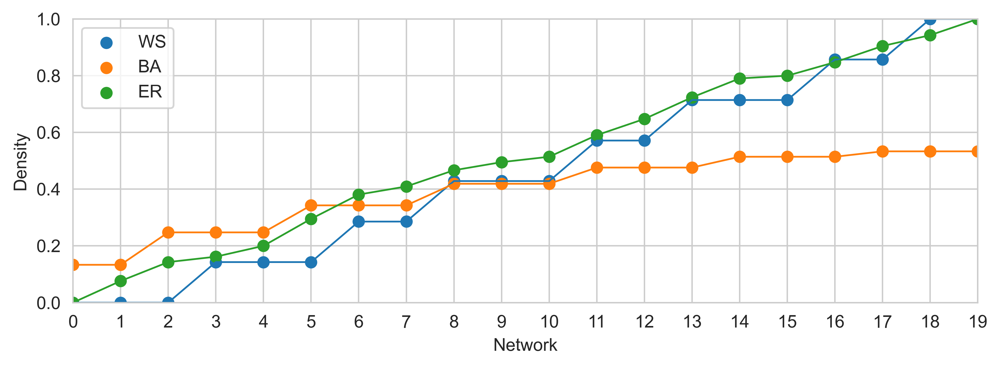

In [17]:
dpi = 500
fig, ax = plt.subplots(figsize=(8,3), dpi=dpi)

# Plot style
sns.set_style("ticks", {"xtick.major.size": 8, "ytick.major.size": 8})
sns.set_style("whitegrid")

# Size of adjacency matrix
N2 = N*N - N

# Calculate the fraction of edges for each network
ws_edges = [np.sum(network_topologies['WS'][i,:,:] != 0)/N2 for i in range(N_networks)]
ba_edges = [np.sum(network_topologies['BA'][i,:,:] != 0)/N2 for i in range(N_networks)]
er_edges = [np.sum(network_topologies['ER'][i,:,:] != 0)/N2 for i in range(N_networks)]

# Plot them
sns.lineplot(x=range(len(ws_edges)), y=ws_edges, ls='-',lw=1)
sns.lineplot(x=range(len(ba_edges)), y=ba_edges, ls='-',lw=1)
sns.lineplot(x=range(len(er_edges)), y=er_edges, ls='-',lw=1)

plt.scatter(x=range(len(ws_edges)), y=ws_edges, label='WS')
plt.scatter(x=range(len(ba_edges)), y=ba_edges, label='BA')
plt.scatter(x=range(len(er_edges)), y=er_edges, label='ER')

# Set title and labels
ax.set_xlabel('Network')
ax.set_ylabel('Density')

ax.set_xlim([0,N_networks-1])
ax.set_ylim([0,1])

ax.set_xticks([i for i in range(N_networks)],[str(i) for i in range(N_networks)])

# Add a legend and gridlines
ax.legend()
ax.grid(True)

# Save the plot
plt.tight_layout()
plt.savefig(f'./EXP2/INPUT_DENSITY.jpg', dpi=dpi)

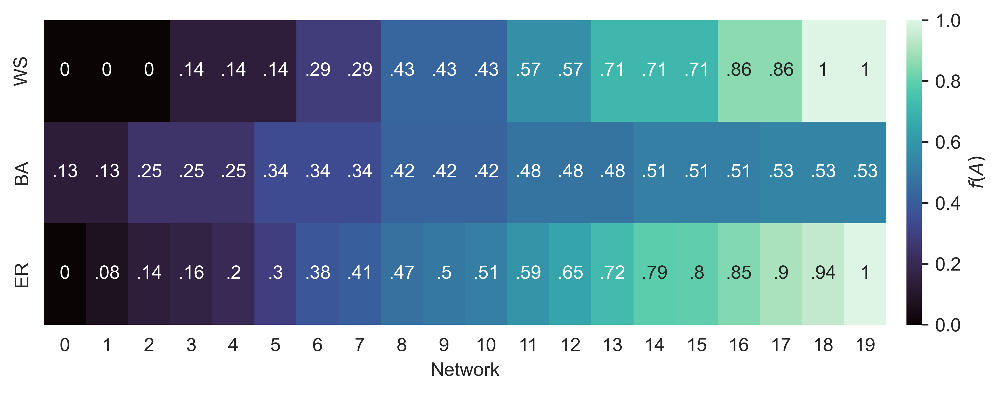

In [34]:
# Network density plot like 
dpi = 550

plt.figure(figsize=(8,3),dpi=dpi)

densities = np.array([ws_edges,ba_edges,er_edges])
data = densities
labels = np.round(data, decimals=2).astype(str)

for i in range(len(labels)):
    for j in range(len(labels[i])):
        if labels[i][j] == '0.0':
            labels[i][j] = '0'
        elif labels[i][j] == '1.0':
            labels[i][j] = '1'
        else:
            labels[i][j] = labels[i][j].lstrip("0")

cmap = 'mako'
sns.heatmap(data, cmap=cmap, annot=labels, annot_kws={'fontsize': 10}, fmt='s',cbar_kws={"ticks": [0, 0.2,0.4,0.6,0.8,1], "label": "$f(A)$",'pad':0.02,'ticks': [0, 0.2,0.4,0.6,0.8, 1]})

plt.yticks([0.5,1.5,2.5], ['WS','BA','ER'])
plt.xlabel('Network')
plt.tight_layout()

plt.savefig('./EXP2/density_matrix.jpg', dpi=dpi)


In [17]:
range(len(ws_edges))

range(0, 20)

In [18]:
for k in network_topologies.keys():
    print(k)

BA
ER
WS


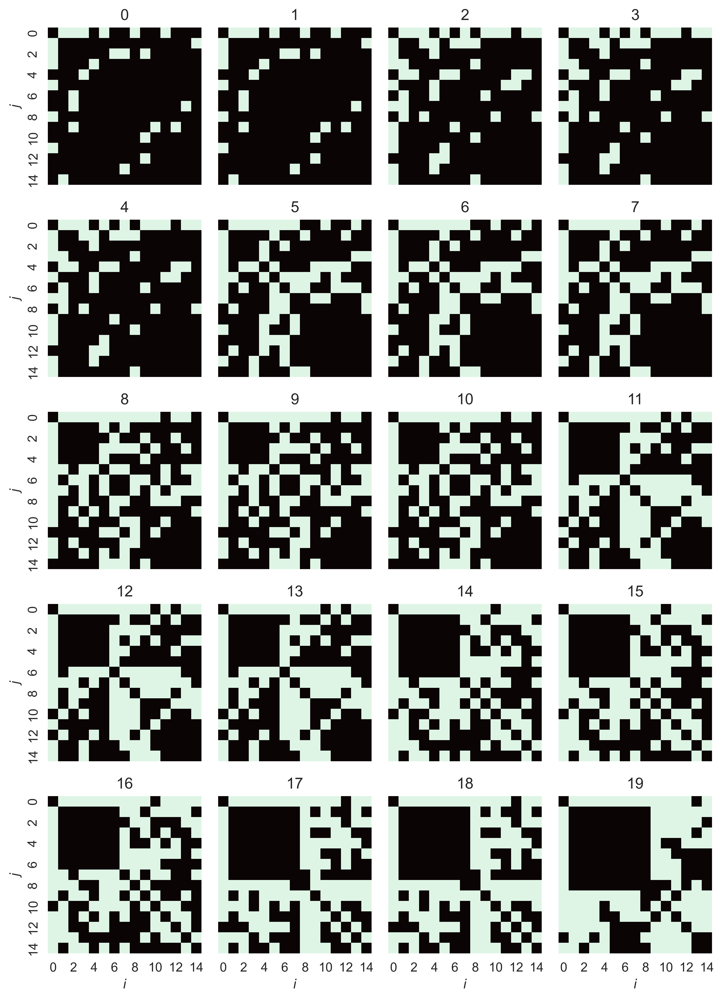

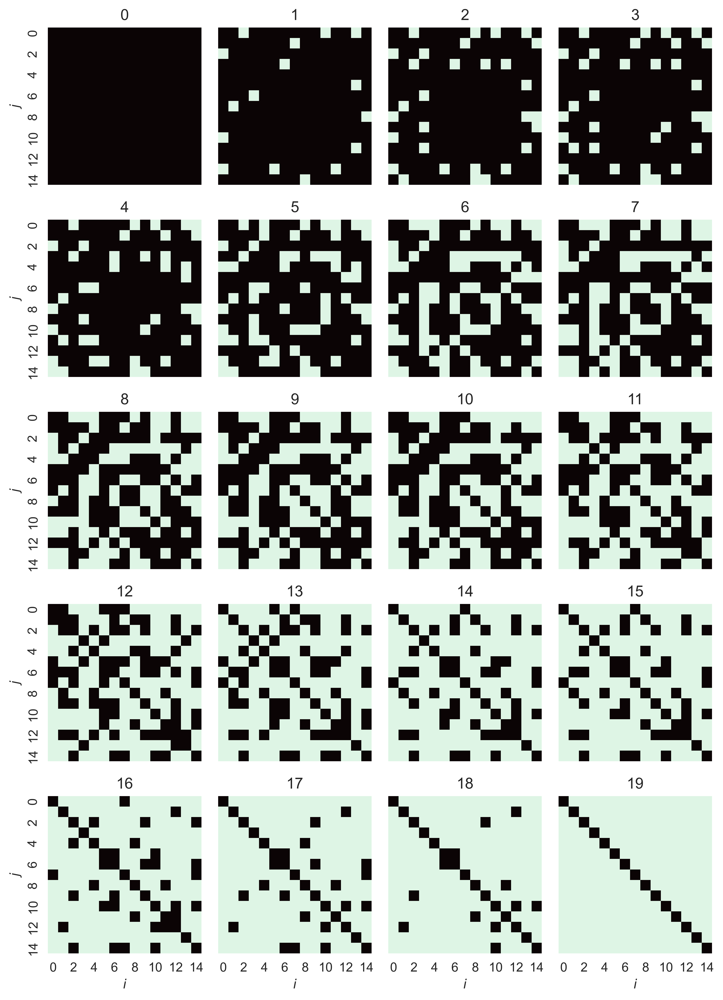

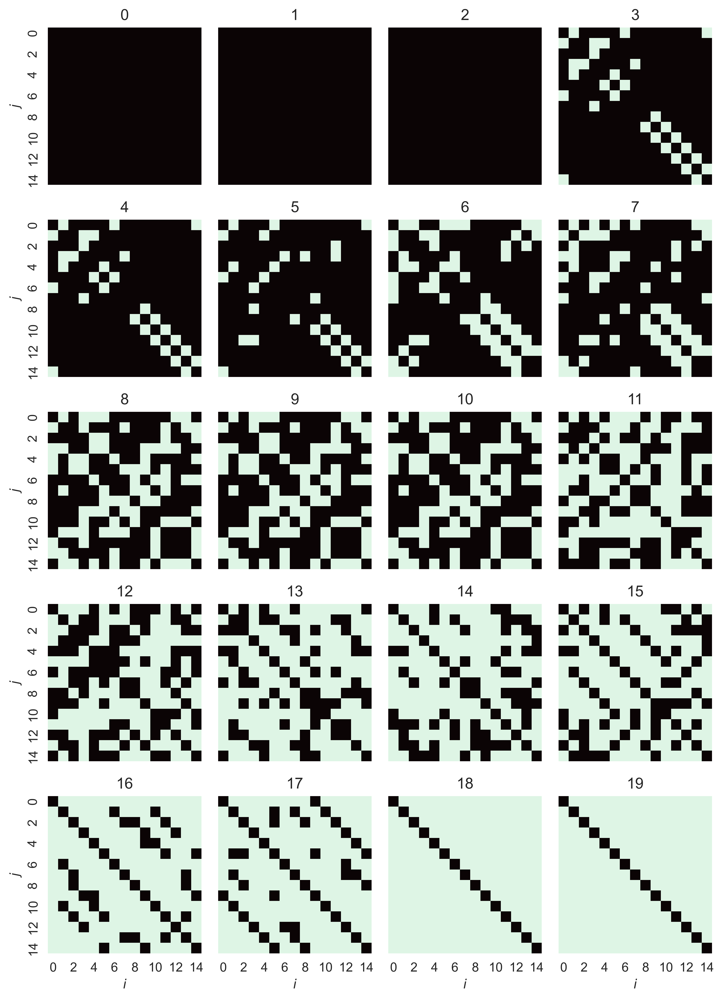

In [38]:
# PLOT ALL ADJACENCY MATRICES
dpi = 500

# Plot structure
num_rows = 5
num_cols = 4

# Create separate plots for each network type
for n_type in network_topologies.keys():

    # Create a figure with subplots
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(8, 11),sharex=True,sharey=True,dpi=dpi)

    # Fill it!
    for i in range(N_networks):
    
        # Retrieve current network
        this_network = network_topologies[n_type][i]

        # Plot it    
        sns.heatmap(this_network, ax=axs.flat[i],vmin=0,vmax=1,cmap='mako',cbar=False)

        # Set y label
        if i in [0,4,8,12,16]:
            axs.flat[i].set_ylabel('$j$')

        # Set x label
        if i in [16,17,18,19]:
            axs.flat[i].set_xlabel('$i$')



        # Add title
        axs.flat[i].set_title(f'{i}')

    # Save the plot
    plt.tight_layout()
    plt.savefig(f'./EXP2/INPUT_ADJ_{n_type}.jpg', dpi=dpi)

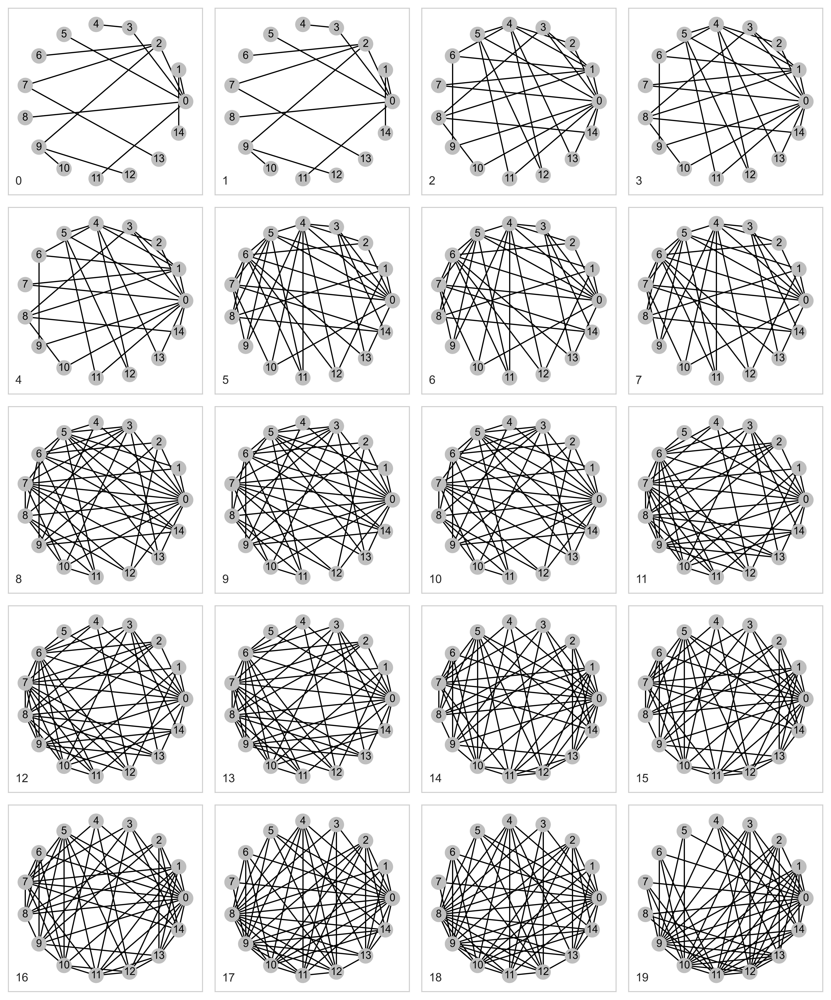

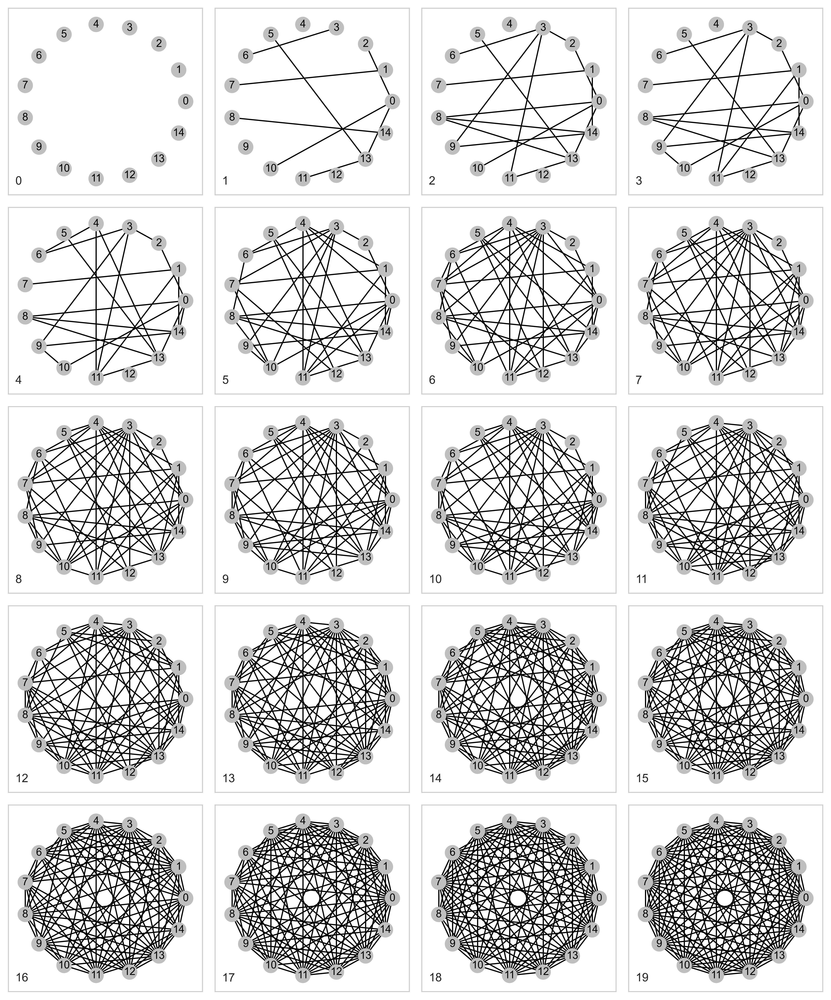

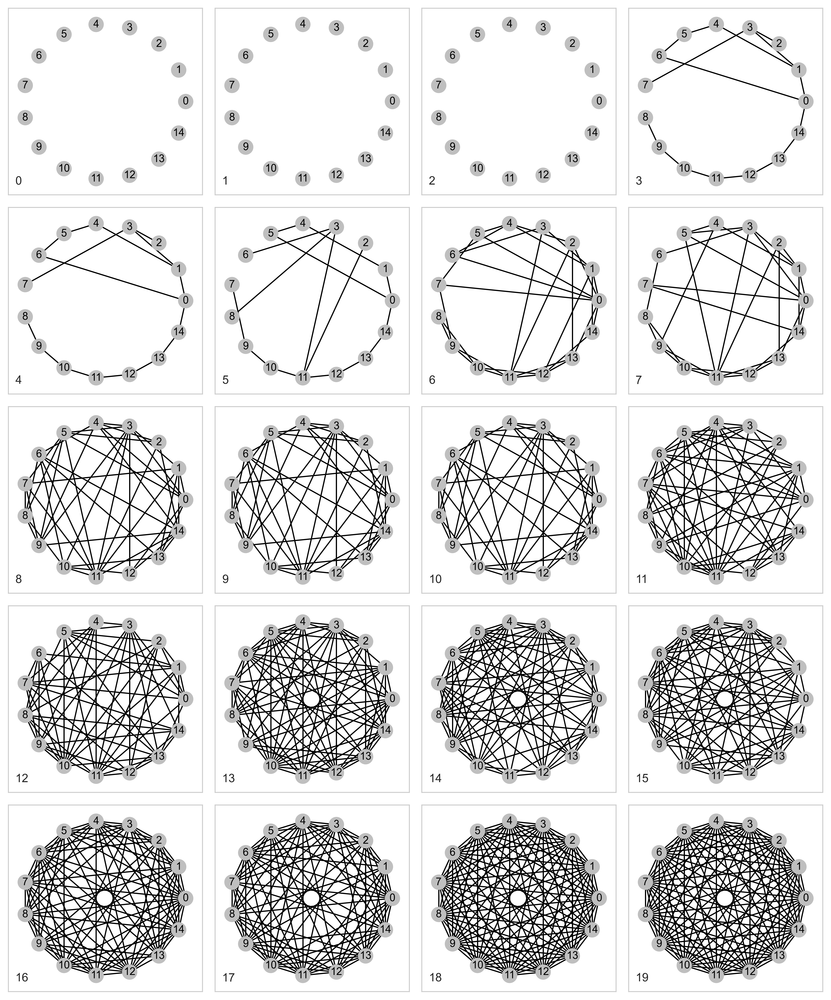

In [20]:
# PLOT ALL NETWORKS
dpi = 500

# Plot structure
num_rows = 5
num_cols = 4

# Create separate plots for each network type
for n_type in network_topologies.keys():

    # Create a figure with subplots
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(10, 12),sharex=True,sharey=True,dpi=dpi)

    # Fill it!
    for i in range(N_networks):
    
        # Retrieve current network
        this_network = network_topologies[n_type][i]

        # Convert it to networkx object
        this_network = nx.from_numpy_array(this_network)

        # Plot it    
        pos = nx.circular_layout(this_network)
        node_color = (0.75,0.75,0.75)
        node_colors = [node_color for i in range(N)]
        nx.draw_networkx(this_network, 
                        ax=axs.flat[i], 
                        pos=pos, 
                        with_labels=True, 
                        node_color=node_colors,
                        node_size=160,
                        font_size=9,
                        linewidths=0.5)

        axs.flat[i].grid(False)
        # Add text with number of network
        axs.flat[i].text(-1.1, -1.1, f'{i}', ha='left', va='bottom', fontsize=10)

    # Save the plot
    plt.tight_layout()
    plt.savefig(f'./EXP2/INPUT_NET_{n_type}.jpg', dpi=dpi)

## 4. Development
Initial distribution of moral development in population

In [40]:
initial_distribution = {}

In [41]:
#####################
# Beta distribution #
#####################

# Desired parameters
mean_min = 0.3
mean_max = 0.9

for variance in variances:
    # Beta distribution
    distributions_beta = np.zeros((N_distribs,N))
    
    # Actual distribution parameters 
    beta_means = np.linspace(mean_min,mean_max,N_distribs)
    beta_variances = variance*np.ones(N_distribs)

    # Tolerance for fitting the distribution 
    tolerance = 1e-12

    # Logging values of actual distribution
    beta_alphas = np.zeros(N_distribs)
    beta_betas  = np.zeros(N_distribs)

    # Obtain the distributions
    for d in range(N_distribs):
        distribution_parameters = get_distribution(beta_means[d],beta_variances[d],tolerance)
        beta_alphas[d] = distribution_parameters['alpha']
        beta_betas[d] = distribution_parameters['beta']
        distributions_beta[d,:] =  get_development_matrix(distribution_parameters,N)
    
    # Create entry on dictionary
    initial_distribution[f'Beta_v{variance}'] = distributions_beta

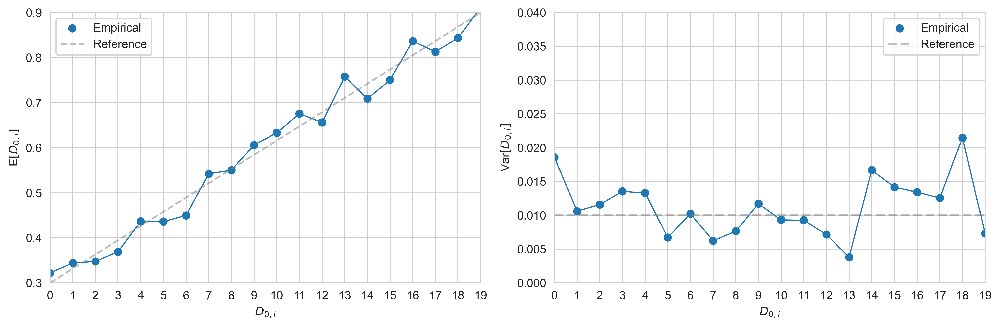

In [24]:
################
# Verification #
################
dpi = 500
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4), dpi=dpi)

# First subplot: Average of distributions
for variance in variances:
    ax1.plot([np.mean(initial_distribution[f'Beta_v{variance}'][i,:]) for i in range(N_distribs)],lw=1)
    ax1.scatter(range(N_distribs),[np.mean(initial_distribution[f'Beta_v{variance}'][i,:]) for i in range(N_distribs)],label='Empirical')

# Theoretical reference
ax1.plot(np.linspace(mean_min,mean_max,N_distribs),ls='--',lw=1.5,label='Reference',c='grey',alpha=0.5)


# Second subplot: Variance of distributions
for variance in variances:
    ax2.plot([np.var(initial_distribution[f'Beta_v{variance}'][i,:]) for i in range(N_distribs)],lw=1)
    ax2.scatter(range(N_distribs),[np.var(initial_distribution[f'Beta_v{variance}'][i,:]) for i in range(N_distribs)],label='Empirical')

# Theoretical reference
ax2.axhline(y=variance,ls='--',lw=2,label='Reference',c='grey',alpha=0.5)

ax1.set_xticks([i for i in range(N_distribs)],[str(i) for i in range(N_distribs)])
ax2.set_xticks([i for i in range(N_distribs)],[str(i) for i in range(N_distribs)])

# Labels
ax1.set_xlabel('$D_{0,i}$')
ax1.set_ylabel('E$[D_{0,i}]$')
ax2.set_xlabel('$D_{0,i}$')
ax2.set_ylabel('Var$[D_{0,i}]$')

# Legend for both subplots
ax1.legend()
ax2.legend()

# Grid for both subplots
ax1.grid(True)
ax2.grid(True)

# Set x axis
ax1.set_xlim([0,N_distribs-1])
ax2.set_xlim([0,N_distribs-1])

# Set y axis
ax1.set_ylim([mean_min,mean_max])
ax2.set_ylim([0,0.04])

# Save the plot
plt.tight_layout()
plt.savefig(f'./EXP2/INPUT_VERIF.jpg', dpi=dpi)

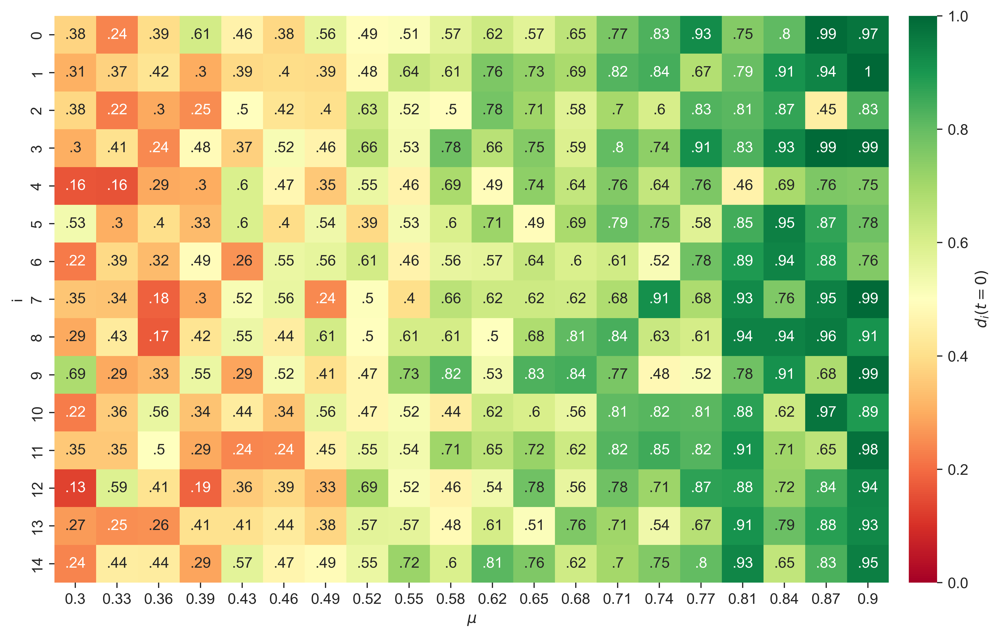

In [53]:
# Plot periphery development and variance?
dpi = 550
plt.figure(figsize=(10,6),dpi=dpi)

labels = np.round(initial_distribution[f'Beta_v{variance}'].T, decimals=2).astype(str)

for i in range(len(labels)):
    for j in range(len(labels[i])):
        if labels[i][j] == '0.0':
            labels[i][j] = '0'
        if labels[i][j] == '1.0':
            labels[i][j] = '1'
        else:
            labels[i][j] = labels[i][j].lstrip("0")

cmap = 'RdYlGn'

sns.heatmap(initial_distribution[f'Beta_v{variance}'].T, vmin=0,vmax=1, cmap=cmap, annot=labels, annot_kws={'fontsize': 10}, fmt='s',cbar_kws={"ticks": [0, 0.2,0.4,0.6,0.8,1], "label": "$d_i(t=0)$",'pad':0.02,'ticks': [0, 0.2,0.4,0.6,0.8, 1]})

x_ticks = plt.xticks()[0]
new_x_ticks = np.round(beta_means,decimals=2)
plt.xticks(x_ticks, new_x_ticks)

plt.xlabel('$\mu$')
plt.ylabel('i')
plt.tick_params(left=True, bottom=True) 

plt.tight_layout()
plt.savefig('./EXP2/INPUT_develop_table.jpg', dpi=dpi)


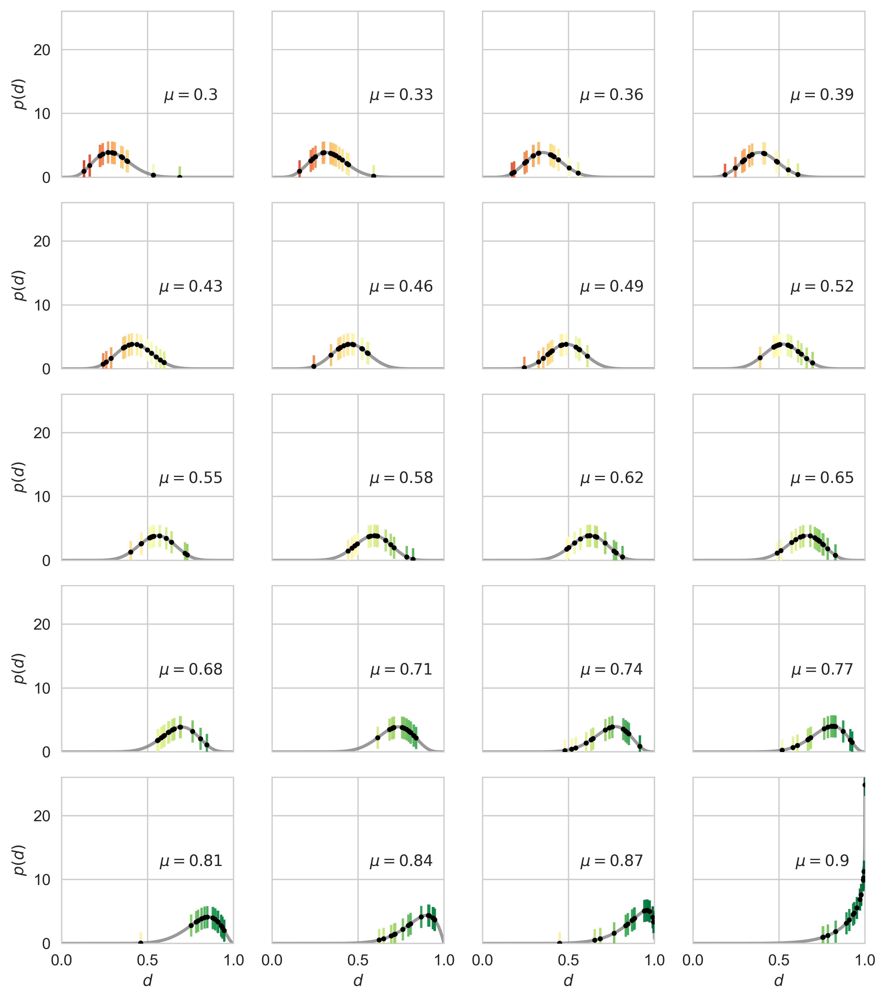

In [27]:
# Plot the specific Beta distributions and their sampled values
dpi = 550
num_rows = 5
num_cols = 4

# Create a figure with subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(8, 9),sharex=True,sharey=True,dpi=dpi)

# Loop through the x1_size
for i in range(N_distribs):
    # Retrieve alpha and beta values
    current_a = beta_alphas[i]
    current_b = beta_betas[i]
        
    # Plot Beta distribution on the current subplot
    x = np.linspace(0.0001,0.9999,1000)
    y = beta.pdf(x,current_a,current_b)

    axs.flat[i].plot(x, y,c='grey', lw=2, alpha=0.8,label=f'$\mu={round(beta_means[i],2)}$',zorder=1)

    # Scatter sampled points on the current subplot
    x_points = initial_distribution[f'Beta_v{variance}'][i]
    y_points = beta.pdf(x_points,current_a,current_b)
    c_points = plt.cm.RdYlGn(x_points)
    axs.flat[i].scatter(x_points,y_points,c=c_points,marker="|",s=200,zorder=20)
    axs.flat[i].scatter(x_points,y_points,c='black',marker=".",s=20,zorder=21)
    
    # Set title and labels for the current subplot
    axs.flat[i].set_xlim([0,1])
    axs.flat[i].set_ylim([0,26])
    axs.flat[i].grid()
    axs.flat[i].text(0.75, 14, f'$\mu = {round(beta_means[i],2)}$', ha='center', va='top', fontsize=10)
    
    if i in [0,4,8,12,16]:
        axs.flat[i].set_ylabel('$p(d)$')

    if i in [16,17,18,19]:
        axs.flat[i].set_xlabel('$d$')

    axs.flat[i].grid(True)

plt.tight_layout()
plt.savefig('./EXP2/distributions_shape.jpg', dpi=dpi)

## 4. Save inputs

### 1. Gather all input data

In [28]:
# Parameters
parameters = {}
parameters['seed_network'] = seed_network
parameters['seed_numpy'] = seed_numpy

parameters['N'] = N
parameters['N_networks'] = N_networks
parameters['N_distribs'] = N_distribs
parameters['variances'] = variances
parameters['R'] = R
parameters['T'] = T

parameters['mean_min'] = mean_min
parameters['mean_max'] = mean_max

parameters['beta_tol'] = tolerance
parameters['beta_alphas'] = beta_alphas
parameters['beta_betas'] = beta_betas

### 1. Create realization folder

In [57]:
experiment_root_folder = 'Exp2'

# Create root folder if not present already
if not os.path.exists(experiment_root_folder):
        os.makedirs(experiment_root_folder)

def get_next_folder_name(folder_path):
    # Get a list of all folders
    folder_list = [int(x) for x in os.listdir(experiment_root_folder) if x.isdigit()]
    folder_list.sort()
    next_folder_name = str(len(folder_list))

    while os.path.exists(os.path.join(folder_path, next_folder_name)):
        next_folder_name = str(int(next_folder_name) + 1)

    return next_folder_name

# Get folder name for this realization
realization_folder_name = get_next_folder_name(experiment_root_folder)

# Get path for the data of this realization
realization_path = f"./{experiment_root_folder}/{realization_folder_name}"

if not os.path.exists(realization_path):
        os.makedirs(realization_path)

### 3. Save inputs

In [58]:
print('Saving in',realization_folder_name) # 38

Saving in 40


In [31]:
# Create input folder
input_path = realization_path +'/' + 'inputs'

# Create root folder if not present already
if not os.path.exists(input_path):
        os.makedirs(input_path)

In [32]:
# Parameters
with open(input_path+'/parameters.pickle', 'wb') as h:
    pickle.dump(parameters, h, protocol=pickle.HIGHEST_PROTOCOL)

# Model
with open(input_path+'/model.pickle', 'wb') as h:
    pickle.dump(model, h, protocol=pickle.HIGHEST_PROTOCOL)

# Network topologies
with open(input_path+'/network_topologies.pickle', 'wb') as h:
    pickle.dump(network_topologies, h, protocol=pickle.HIGHEST_PROTOCOL)

# Development distributions
with open(input_path+'/initial_distribution.pickle', 'wb') as h:
    pickle.dump(initial_distribution, h, protocol=pickle.HIGHEST_PROTOCOL)

___

# 2. Simulation

### 1. Load inputs

In [10]:
realization_folder_name = '38'
experiment_root_folder = 'Exp2'

realization_path = f"./{experiment_root_folder}/{realization_folder_name}"
input_path = realization_path +'/' + 'inputs'

In [11]:
# Parameters
with open(input_path+'/parameters.pickle', 'rb') as h:
    parameters = pickle.load(h)
    seed_network = parameters['seed_network']
    seed_numpy = parameters['seed_numpy']

    N = parameters['N'] 
    N_networks = parameters['N_networks'] 
    N_distribs = parameters['N_distribs']
    variances = parameters['variances'] 
    R = parameters['R']
    T = parameters['T']

    tolerance = parameters['beta_tol']
    beta_alphas = parameters['beta_alphas']
    beta_betas = parameters['beta_betas']

# Model
with open(input_path+'/model.pickle', 'rb') as h:
    model = pickle.load(h)

# Network topologies
with open(input_path+'/network_topologies.pickle', 'rb') as h:
    network_topologies = pickle.load(h)

# Development distributions
with open(input_path+'/initial_distribution.pickle', 'rb') as h:
    initial_distribution = pickle.load(h)

In [12]:
parameters

{'seed_network': 42,
 'seed_numpy': 22,
 'N': 15,
 'N_networks': 20,
 'N_distribs': 20,
 'variances': [0.01],
 'R': 30,
 'T': 300,
 'beta_tol': 1e-12,
 'beta_alphas': array([ 6.        ,  7.01734947,  8.03574865,  9.03630267, 10.00011664,
        10.90829567, 11.74194489, 12.48216941, 13.11007435, 13.60676483,
        13.95334597, 14.13092288, 14.12060067, 13.90348447, 13.4606794 ,
        12.77329057, 11.82242309, 10.5891821 ,  9.05467269,  7.2       ]),
 'beta_betas': array([14.        , 14.14608544, 14.09167517, 13.85566409, 13.45694708,
        12.91441901, 12.24697478, 11.47350926, 10.61291733,  9.68409389,
         8.70593381,  7.69733197,  6.67718326,  5.66438256,  4.67782476,
         3.73640472,  2.85901735,  2.06455752,  1.3719201 ,  0.8       ])}

### 2. Create results folder

In [62]:
# Create results folder
results_path = realization_path +'/' + 'results'

# Create results folder if not present already
if not os.path.exists(results_path):
        os.makedirs(results_path)
else:
        print('Folder already exists!')

Folder already exists!


In [63]:
# List types of network topology
topology_types = list(network_topologies.keys())
distribution_types = list(initial_distribution.keys())

# Create subfolders for each network topology
for topology in topology_types:
    
    results_topology_path = results_path +'/' + topology
    if not os.path.exists(results_topology_path):
        os.makedirs(results_topology_path)

    # Also create subfolders for each distribution
    for distribution in distribution_types:

        results_distribution_path = results_topology_path + '/' + distribution
        if not os.path.exists(results_distribution_path):
            os.makedirs(results_distribution_path)   

## 3. Run model

Iterate for all types within the experiment.

Indexing is done by:
1. Topology = ['ER'.'BA','WS']
2. Distribution = ['Beta_v0.01', 'Beta_v0.02', 'Beta_v0.03', 'Beta_v0.04'])
3. Connectivity = [0,1,2]  - [0,...,N_networks]
4. Average = [0,1,2]  - [0,...,N_distribs]


In [9]:
results_path = realization_path +'/' + 'results'
results_path

'./Exp2/38/results'

In [10]:
# Logging: For printing progress
n_combinations = len(network_topologies.keys())*len(initial_distribution.keys())
counter = 1

for topology_type in network_topologies.keys():

    # Retrieve the topology subfolder
    results_topology_path = results_path +'/'+ topology_type

    for distribution_type in initial_distribution.keys():
    
        # Retrieve the distribution subfolder
        results_distribution_path = results_topology_path + '/' + distribution_type

        # Logging: print current element and create a progress bar
        print(f"{counter}/{n_combinations}: {topology_type} | {distribution_type}")
        pbar = tqdm.tqdm(total=N_networks * N_distribs)  

        for i in range(N_networks):
    
            # Retrieve current sub-topology
            network = network_topologies[topology_type][i,:,:]

            for j in range(N_distribs):
    
                # Retrieve current sub-distribution
                development = initial_distribution[distribution_type][j,:]

                # Run model
                result = run_model_n_times(runs=R,
                                            timesteps=T,
                                            model=model,
                                            network=network,
                                            development=development)

                # Get result filepath
                result_filename = f'{i}_{j}.pickle'
                result_path = results_distribution_path + '/' + result_filename

                # Save result to disk
                with open(result_path, 'wb') as h:
                    pickle.dump(result, h, protocol=pickle.HIGHEST_PROTOCOL)

                # Logging: Update the progress bar
                pbar.update(1)  

        # Logging: Close the progress bar and update the counter
        pbar.close()  
        counter += 1
                

1/3: BA | Beta_v0.01


  0%|          | 0/400 [00:00<?, ?it/s]

100%|██████████| 400/400 [30:41<00:00,  4.60s/it]


2/3: ER | Beta_v0.01


100%|██████████| 400/400 [45:01<00:00,  6.75s/it]   


3/3: WS | Beta_v0.01


100%|██████████| 400/400 [29:43<00:00,  4.46s/it]


# 3. Metric generation

## 1. Folder creation

In [13]:
realization_folder_name = '38'
experiment_root_folder = 'Exp2'

realization_path = f"./{experiment_root_folder}/{realization_folder_name}"
results_path = realization_path +'/' + 'results'

In [14]:
# Metric folder
metric_path = realization_path +'/' + 'metrics'

# Create metric folder if not present already
if not os.path.exists(metric_path):
        os.makedirs(metric_path)

___

In [15]:
# Subfolders

# List types of network topology
topology_types = list(network_topologies.keys())
distribution_types = list(initial_distribution.keys())

# Create subfolders for each network topology
for topology in topology_types:
    
    metric_topology_path = metric_path +'/' + topology
    if not os.path.exists(metric_topology_path):
        os.makedirs(metric_topology_path)

    # Also create subfolders for each distribution
    for distribution in distribution_types:

        metric_distribution_path = metric_topology_path + '/' + distribution
        if not os.path.exists(metric_distribution_path):
            os.makedirs(metric_distribution_path)   

## 2. Computing the metric

In [16]:
# Metric name for the folder
metric_name = 'final_average_development'

# We save one metric file per network and distribution
# Containing all N_networks and N_distribs
metric = np.zeros((N_networks,N_distribs))
metric_v = np.zeros((N_networks,N_distribs))

for topology_type in network_topologies.keys():
    metric_topology_path = metric_path +'/' + topology_type
        
    for distribution_type in initial_distribution.keys():
        metric_distribution_path = metric_topology_path + '/' + distribution_type

        for i in range(N_networks):
            for j in range(N_distribs):

                # Result filename
                result_filename = f'{i}_{j}.pickle'
                results_topology_path = results_path +'/'+ topology_type
                results_distribution_path = results_topology_path + '/' + distribution_type
                result_path = results_distribution_path + '/' + result_filename

                # Retrieve result
                with open(result_path, 'rb') as h:
                    result = pickle.load(h)

                # Compute metric
                average_morality = np.mean(result['node_development'][:,T-1,:],axis=(0,1))
                variance_last_am = np.var(result['node_development'][:,T-1,:],axis=(0,1))

                # Save to the data structure
                metric[i,j] = average_morality
                metric_v[i,j] = variance_last_am
        
        # Save the metric to disk
        metric_file_path = metric_distribution_path + '/' + f'final_average_development.npy'
        np.save(metric_file_path, metric)

        metric_file_path = metric_distribution_path + '/' + f'final_average_development_var.npy'
        np.save(metric_file_path, metric_v)

___

# 3. Plotting

## 0. Create folder

In [17]:
# Metric folder
figures_path = realization_path +'/' + 'figures'

# Create metric folder if not present already
if not os.path.exists(figures_path):
        os.makedirs(figures_path)

figures_path

'./Exp2/38/figures'

## 1. Load data

In [18]:
metric_name = 'final_average_development'
metric_name_v = 'final_average_development_var'

# This metric is proxy for final regime of network: fixed equilibrium or ME different from bystability
metric = np.zeros((len(network_topologies.keys()),len(initial_distribution.keys()),N_networks,N_distribs))
metric_v = np.zeros((len(network_topologies.keys()),len(initial_distribution.keys()),N_networks,N_distribs))

for i, (topology_type, value_t) in enumerate(network_topologies.items()):
    metric_topology_path = metric_path +'/' + topology_type

    for j, (distribution_type, value_d) in enumerate(initial_distribution.items()):
        metric_distribution_path = metric_topology_path + '/' + distribution_type
        
        file_path = metric_distribution_path + '/' + metric_name + '.npy'
        current_metric = np.load(file_path)
        metric[i,j,:,:] = current_metric
        
        file_path = metric_distribution_path + '/' + metric_name_v + '.npy'
        current_metric = np.load(file_path)
        metric_v[i,j,:,:] = current_metric

## 2. Plot

In [19]:
# Retrieve beta means
mean_min = 0.3
mean_max = 0.9
beta_means = np.linspace(mean_min,mean_max,N_distribs)

In [21]:
np.round(beta_means,decimals=2)

array([0.3 , 0.33, 0.36, 0.39, 0.43, 0.46, 0.49, 0.52, 0.55, 0.58, 0.62,
       0.65, 0.68, 0.71, 0.74, 0.77, 0.81, 0.84, 0.87, 0.9 ])

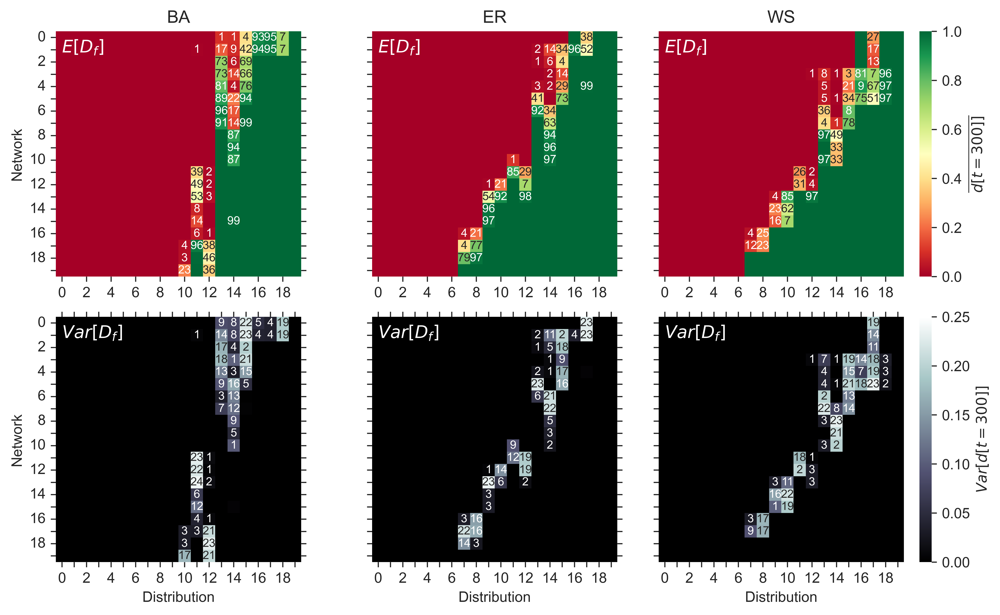

In [74]:
# Plot of metric
dpi = 650
fig, axs = plt.subplots(2, 3, figsize=(10, 6), dpi=dpi,sharey=True)

for row in range(2):    
    # Plot means
    if row==0:
        cmap = 'RdYlGn'

        # Each of the subplots
        for subp in range(3):
            data = metric[subp][0]
            labels = np.round(data, decimals=2).astype(str)

            # Update labels text
            for i in range(len(labels)):
                for j in range(len(labels[i])):
                    if labels[i][j] == '0':
                        labels[i][j] = '0'
                    if labels[i][j] == '1':
                        labels[i][j] = '100'
                    else:
                        labels[i][j] = labels[i][j][2:].lstrip("0")

            # Define colorbar presence (only for subplot on the right)
            cbar = True if subp == 2 else False

            # Plot the data
            sns.heatmap(data,annot=labels, cmap=cmap,annot_kws={'fontsize': 8}, fmt='s',ax=axs.flat[subp],vmin=0,vmax=1,cbar=cbar,cbar_kws={'label':'$\overline{d[t=300]]}$'})

            # Set aspect ratio of each subplot to 'equal' before plotting
            axs.flat[subp].set_aspect('equal')

    # Plot variances
    if row==1:
        cmap = 'bone'

        # Each of the subplots
        for subp in range(3):
            data = metric_v[subp][0]
            labels = np.round(data, decimals=2).astype(str)

            for i in range(len(labels)):
                for j in range(len(labels[i])):
                    if labels[i][j] == '0':
                        labels[i][j] = '0'
                    if labels[i][j] == '1':
                        labels[i][j] = '100'
                    else:
                        labels[i][j] = labels[i][j][2:].lstrip("0")

            # Define colorbar presence (only for subplot on the right)
            cbar = True if subp == 2 else False

            # Plot the data
            sns.heatmap(data,annot=labels, cmap=cmap,annot_kws={'fontsize': 8}, fmt='s',ax=axs.flat[subp+3],vmin=0,vmax=0.25,cbar=cbar,cbar_kws={'label':'$Var[d[t=300]]$'})
            axs.flat[subp+3].set_aspect('equal')

# Axis label: x
axs.flat[3].set_xlabel('Distribution')
axs.flat[4].set_xlabel('Distribution')
axs.flat[5].set_xlabel('Distribution')

# Axis label: y
axs.flat[0].set_ylabel('Network')
axs.flat[3].set_ylabel('Network')

xlabels = [str(i) if (i+1)%2 else '' for i in range(metric.shape[2])]
axs.flat[5].set_xticks([i+0.5 for i in range(metric.shape[2])],xlabels,rotation=0)
axs.flat[4].set_xticks([i+0.5 for i in range(metric.shape[2])],xlabels,rotation=0)
axs.flat[3].set_xticks([i+0.5 for i in range(metric.shape[2])],xlabels,rotation=0)

ylabels = [str(i) if (i+1)%2 else '' for i in range(metric.shape[3])]
axs.flat[0].set_yticks([i+0.5 for i in range(metric.shape[3])],ylabels,rotation=0)
axs.flat[3].set_yticks([i+0.5 for i in range(metric.shape[3])],ylabels,rotation=0)

# Title
axs.flat[0].set_title('BA')
axs.flat[1].set_title('ER')
axs.flat[2].set_title('WS')

# Axis tick lines
axs.flat[0].tick_params(left=True, bottom=True,right=True)
axs.flat[1].tick_params(left=True, bottom=True,right=True)
axs.flat[2].tick_params(left=True, bottom=True)
axs.flat[3].tick_params(left=True, bottom=True,top=True,right=True)
axs.flat[4].tick_params(left=True, bottom=True,top=True,right=True)
axs.flat[5].tick_params(left=True, bottom=True,top=True)

plt.tight_layout()
plt.savefig(f'{figures_path}/RESULT_FINAL_M.jpg', dpi=dpi)

/tmp/ipykernel_2019/345818106.py:93: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


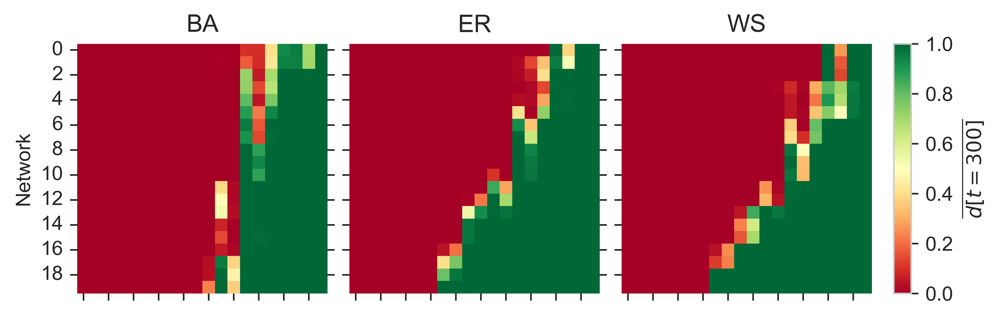

In [107]:
from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib.cm

dpi = 550
fig = plt.figure(figsize=(7, 3),dpi=dpi)

grid = ImageGrid(fig, 111,          # as in plt.subplot(111)
                 nrows_ncols=(1,3),
                 axes_pad=0.15,
                 share_all=True,
                 cbar_location="right",
                 cbar_mode="single",
                 cbar_size="7%",
                 cbar_pad=0.15,
                 )

# Add data to image grid
k = 0
for ax in grid:

    data = metric[k][0]
    labels = np.round(data, decimals=2).astype(str)
    
    for i in range(len(labels)):
        for j in range(len(labels[i])):
            labels[i][j] = labels[i][j].replace('0.','')
            if labels[i][j] == '0':
                labels[i][j] = ''
            if labels[i][j] == '1.0':
                labels[i][j] = '' 
            labels[i][j] = labels[i][j].lstrip("0")

    cmap = 'RdYlGn' # 'rocket' #

    this_plot = sns.heatmap(data, fmt='s',ax=ax,vmin=0,vmax=1,cbar=False,cmap=cmap)

    # Dummy data to have a colorbar in the end
    im = ax.imshow(np.random.random((10,10)), vmin=0, vmax=1,cmap=cmap)

    # Tiks and colorbar
    if k<2:
        ax.tick_params(left=True, bottom=True,right=True)
    else:
        ax.tick_params(left=True, bottom=True,right=False)
        cbar = ax.cax.colorbar(im)
        cbar.set_label('$\overline{d[t=300]}$')
    
    ax.set_ylabel('Network')
    ax.tick_params(axis='y', labelrotation=0)
    ax.tick_params(labelbottom=False)
    ax.set_xlabel('')

    # Update counter
    k += 1

# Title
grid[0].set_title('BA')
grid[1].set_title('ER')
grid[2].set_title('WS')

plt.tight_layout()
plt.savefig(f'{figures_path}/RESULT_FINAL_M_FIX.jpg', dpi=dpi)

/tmp/ipykernel_2019/128643441.py:94: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


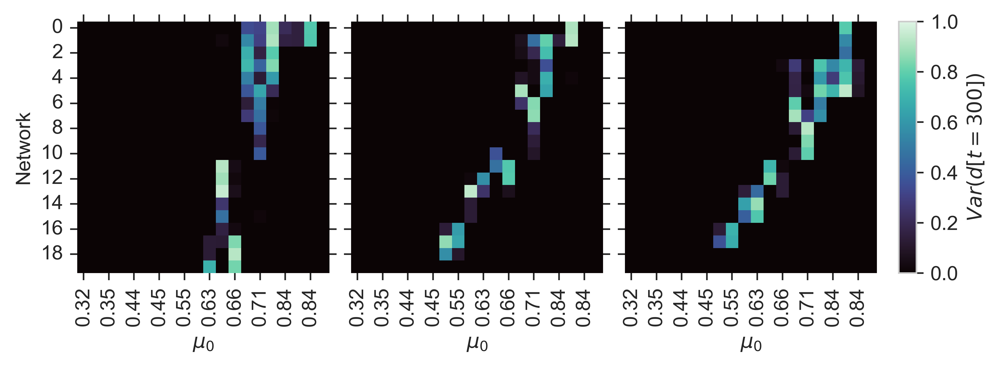

In [109]:
from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib.cm

dpi = 550
fig = plt.figure(figsize=(7, 3),dpi=dpi)

grid = ImageGrid(fig, 111,          # as in plt.subplot(111)
                 nrows_ncols=(1,3),
                 axes_pad=0.15,
                 share_all=True,
                 cbar_location="right",
                 cbar_mode="single",
                 cbar_size="7%",
                 cbar_pad=0.15,
                 )

# Add data to image grid
k = 0
for ax in grid:

    data = metric_v[k][0]
    labels = np.round(data, decimals=2).astype(str)

    for i in range(len(labels)):
        for j in range(len(labels[i])):
            labels[i][j] = labels[i][j].replace('0.','')
            if labels[i][j] == '0':
                labels[i][j] = ''
            if labels[i][j] == '1.0':
                labels[i][j] = '' 
            labels[i][j] = labels[i][j].lstrip("0")

    cmap = 'mako' # 'rocket' #
    this_plot = sns.heatmap(data, fmt='s',ax=ax,vmin=0,vmax=0.25,cbar=False,cmap=cmap)

    # Dummy data to have a colorbar in the end
    im = ax.imshow(np.random.random((10,10)), vmin=0, vmax=1,cmap=cmap)

    # Tiks and colorbar
    if k<2:
        ax.tick_params(left=True, bottom=True,right=True,top=True)
    else:
        ax.tick_params(left=True, bottom=True,right=False,top=True)
        cbar = ax.cax.colorbar(im)
        cbar.set_label('$Var(d[t=300])$')
    
    ax.set_ylabel('Network')
    ax.tick_params(axis='y', labelrotation=0)

    xlabels = np.round(np.mean(initial_distribution[f'Beta_v{variance}'][::2],axis=1),2).astype(str)
    XTICKS = [ 0.5,  2.5,  4.5,  6.5,  8.5, 10.5, 12.5, 14.5, 16.5, 18.5]  
    ax.set_xticks(XTICKS,xlabels)
    ax.tick_params(axis='x', labelrotation=90)

    ax.tick_params(labelbottom=True)    
    ax.set_xlabel('$\mu_0$')

    # Update counter
    k += 1

plt.tight_layout()
plt.savefig(f'{figures_path}/RESULT_FINAL_MVAR_FIX.jpg', dpi=dpi)

In [24]:
variance = 0.01
np.round(np.mean(initial_distribution[f'Beta_v{variance}'],axis=1),2)

array([0.32, 0.34, 0.35, 0.37, 0.44, 0.44, 0.45, 0.54, 0.55, 0.61, 0.63,
       0.68, 0.66, 0.76, 0.71, 0.75, 0.84, 0.81, 0.84, 0.91])

In [87]:
np.mean(initial_distribution[f'Beta_v{variance}'][i,:])

np.float64(0.9113470162128934)

___

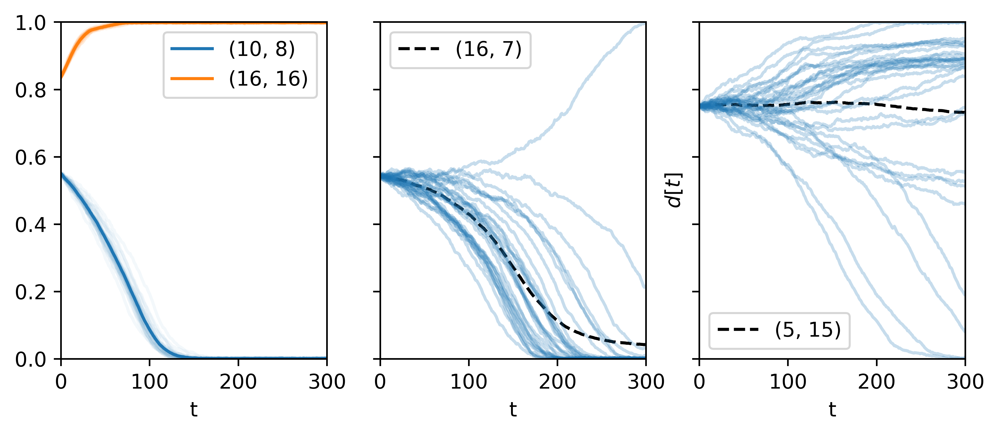

In [27]:
# DO 3 plots for same type of network
topology_plot = 'ER'
dpi=550
fig, axs = plt.subplots(1, 3, figsize=(8, 3), dpi=dpi,sharey=True)

# First subplot
regimes = [(10,8),(16,16)]
colors = ['tab:blue','tab:orange']

for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'

    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean as a line plot
    axs[0].plot(dev_t,label=f'{regime1}',c=colors[index])

    # Calculate the minimum and maximum values to use for filling
    min_val = dev_t - 2 * np.sqrt(dev_tv)
    max_val = dev_t + 2 * np.sqrt(dev_tv)

    # Plot all runs
    for r in range(R):
        axs[0].plot(np.mean(data['node_development'][r,:,:],axis=1),c=colors[index],alpha=0.05)

# Second subplot
regimes = [(16,7)]
for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'
   
    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean as a line plot
    axs[1].plot(dev_t,label=f'{regime1}',ls='--',c='black')

    # Calculate the minimum and maximum values to use for filling
    min_val = dev_t - 2 * np.sqrt(dev_tv)
    max_val = dev_t + 2 * np.sqrt(dev_tv)

    # Plot all runs
    for r in range(R):
        axs[1].plot(np.mean(data['node_development'][r,:,:],axis=1),c='tab:blue',alpha=0.25)

# Third subplot
regimes = [(5,15)]

for index in range(len(regimes)):
    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'
   
    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean as a line plot
    axs[2].plot(dev_t,label=f'{regime1}',ls='--',c='black')

    # Calculate the minimum and maximum values to use for filling
    min_val = dev_t - 2 * np.sqrt(dev_tv)
    max_val = dev_t + 2 * np.sqrt(dev_tv)

    # Plot all runs
    for r in range(R):
        axs[2].plot(np.mean(data['node_development'][r,:,:],axis=1),c='tab:blue',alpha=0.25)

axs[1].set_xlim([0,T])
axs[1].set_ylim([0,1])
axs[1].set_xlabel('t')
axs[1].legend()

axs[0].set_xlim([0,T])
axs[0].set_ylim([0,1])
axs[0].set_xlabel('t')
axs[0].legend()

axs[2].set_xlim([0,T])
axs[2].set_ylim([0,1])
axs[2].set_xlabel('t')
axs[2].set_ylabel('$d[t]$')
axs[2].legend()

plt.show()

## Metric: ME

In [556]:
# Metric name for the folder
metric_name = 'ME_presence'
metricME   = np.zeros((N_networks,N_distribs))

# Function to determine % ME
d_min = 0.1
d_max = 0.9

def fraction_between(arr,d_min,d_max):
    mask = (arr >= d_min) & (arr <= d_max)
    return np.mean(mask)

for topology_type in network_topologies.keys():
    metric_topology_path = metric_path +'/' + topology_type
        
    for distribution_type in initial_distribution.keys():
        metric_distribution_path = metric_topology_path + '/' + distribution_type

        for i in range(N_networks):
            for j in range(N_distribs):

                # Result filename
                result_filename = f'{i}_{j}.pickle'
                results_topology_path = results_path +'/'+ topology_type
                results_distribution_path = results_topology_path + '/' + distribution_type
                result_path = results_distribution_path + '/' + result_filename

                # Retrieve result
                with open(result_path, 'rb') as h:
                    result = pickle.load(h)

                # Compute metric
                distribution_final_dev_each_run = np.mean(result['node_development'][:,T-1,:],axis=1)
                fraction = fraction_between(distribution_final_dev_each_run,d_min,d_max)
    
                # Save to the data structure
                metricME[i,j] = fraction
        
        # Save the metric to disk
        metric_file_path = metric_distribution_path + '/' + f'{metric_name}.npy'
        np.save(metric_file_path, metricME)



In [111]:
# Load ME metric
metricME = {}

metric_name = 'ME_presence'
for topology_type in network_topologies.keys():
    metric_topology_path = metric_path +'/' + topology_type
        
    for distribution_type in initial_distribution.keys():
        metric_distribution_path = metric_topology_path + '/' + distribution_type
        metric_file_path = metric_distribution_path + '/' + f'{metric_name}.npy'
        
        me_metric = np.load(metric_file_path)

        metricME[topology_type] = me_metric

        print(metric_file_path)


./Exp2/38/metrics/BA/Beta_v0.01/ME_presence.npy
./Exp2/38/metrics/ER/Beta_v0.01/ME_presence.npy
./Exp2/38/metrics/WS/Beta_v0.01/ME_presence.npy


/tmp/ipykernel_2019/1968940873.py:94: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


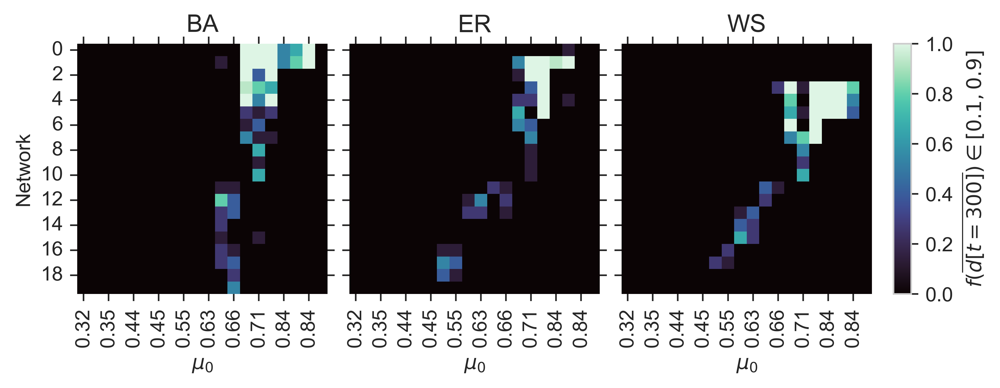

In [120]:
from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib.cm

dpi = 550
fig = plt.figure(figsize=(7, 3),dpi=dpi)

grid = ImageGrid(fig, 111,          # as in plt.subplot(111)
                 nrows_ncols=(1,3),
                 axes_pad=0.15,
                 share_all=True,
                 cbar_location="right",
                 cbar_mode="single",
                 cbar_size="7%",
                 cbar_pad=0.15,
                 )

# Add data to image grid
k = 0
for ax in grid:

    data = metricME[topology_types[k]]
    labels = np.round(data, decimals=2).astype(str)
    
    for i in range(len(labels)):
        for j in range(len(labels[i])):
            labels[i][j] = labels[i][j].replace('0.','')
            if labels[i][j] == '0':
                labels[i][j] = ''
            if labels[i][j] == '1.0':
                labels[i][j] = '' 
            labels[i][j] = labels[i][j].lstrip("0")

    cmap = 'mako' # 'rocket' #
    this_plot = sns.heatmap(data, fmt='s',ax=ax,vmin=0,vmax=0.25,cbar=False,cmap=cmap)

    # Dummy data to have a colorbar in the end
    im = ax.imshow(np.random.random((10,10)), vmin=0, vmax=1,cmap=cmap)

    # Tiks and colorbar
    if k<2:
        ax.tick_params(left=True, bottom=True,right=True,top=True)
    else:
        ax.tick_params(left=True, bottom=True,right=False,top=True)
        cbar = ax.cax.colorbar(im)
        cbar.set_label('$f(\overline{d[t=300]}) \in [0.1,0.9]$')
    
    ax.set_ylabel('Network')
    ax.tick_params(axis='y', labelrotation=0)

    xlabels = np.round(np.mean(initial_distribution[f'Beta_v{variance}'][::2],axis=1),2).astype(str)
    XTICKS = [ 0.5,  2.5,  4.5,  6.5,  8.5, 10.5, 12.5, 14.5, 16.5, 18.5]  

    ax.set_xticks(XTICKS,xlabels)
    ax.tick_params(axis='x', labelrotation=90)
    ax.tick_params(labelbottom=True)
    ax.set_xlabel('$\mu_0$')

    # Update counter
    k += 1

# Title
grid[0].set_title('BA')
grid[1].set_title('ER')
grid[2].set_title('WS')

plt.tight_layout()
plt.savefig(f'{figures_path}/RESULT_FINAL_METRIC_FIX.jpg', dpi=dpi)

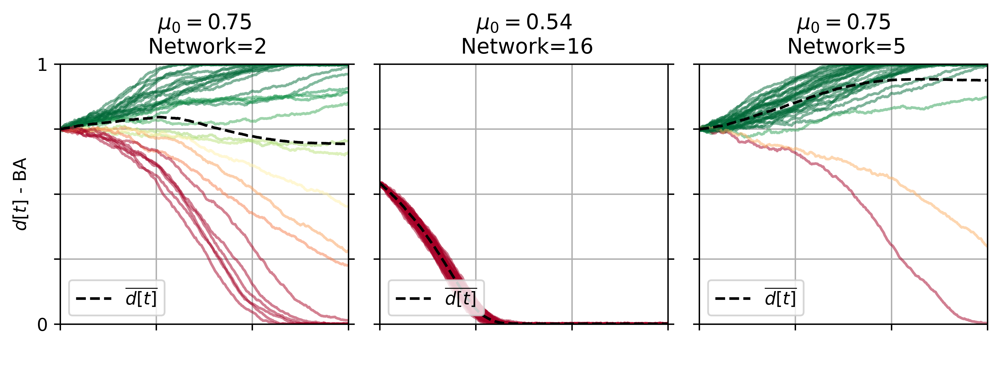

In [150]:
# Pick which plot to do
TOP = True
MIDDLE = False
BOTTOM = False

dpi = 550
regimes = [(2,15),(16,7),(5,15)]
fig, axs = plt.subplots(1, 3, figsize=(8, 3), dpi=dpi,sharey=True)

for index in range(len(regimes)):

    if TOP:
        topology_plot = 'BA'
    elif MIDDLE:
        topology_plot = 'ER'
    else: 
        topology_plot = 'WS'

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'

    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean
    axs[index].plot(dev_t,ls='--',c='black',label='$\overline{d[t]}$',zorder=5,lw=1.5)

    # Plot all runs
    for r in range(R):
        last_m_value = np.mean(data['node_development'][r,T-1,:])
        c = plt.cm.RdYlGn(last_m_value)

        axs[index].plot(np.mean(data['node_development'][r,:,:],axis=1),c=c,alpha=0.5)

    axs[index].set_xlim([0,300])
    axs[index].set_ylim([0,1])
    axs[index].legend(loc='lower left')

    if TOP:
        # Title
        title_str = round(np.mean(initial_distribution[f'Beta_v{variance}'][regime1[1]]),2)
        axs[index].set_title('$\mu_0=$'+f'{title_str}\n Network={regime1[0]}')#f'{topology_plot}{regime1}')
        axs[index].tick_params(bottom=True)
        axs[index].tick_params(labelbottom=False)
        axs[index].set_xlabel(' ')
    elif MIDDLE:
        axs[index].set_title('')
        axs[index].tick_params(bottom=True,top=True)
        axs[index].tick_params(labelbottom=False)
        axs[index].set_xlabel(' ')
    else:
        axs[index].set_title('')
        axs[index].tick_params(bottom=True,top=True)
        axs[index].tick_params(labelbottom=True)
        axs[index].set_xlabel('t')
        axs[index].set_xticks([0,100,200,300],['0','100','200',''])

    if index < 2:
        axs[index].tick_params(right=True)

    axs[index].set_yticks([0,0.25,0.5,0.75,1],['0','','','','1'])
    axs[index].grid(True)

# Common fixes
axs[0].set_ylabel('$d[t]$ - '+f'{topology_plot}')
plt.tight_layout()

___

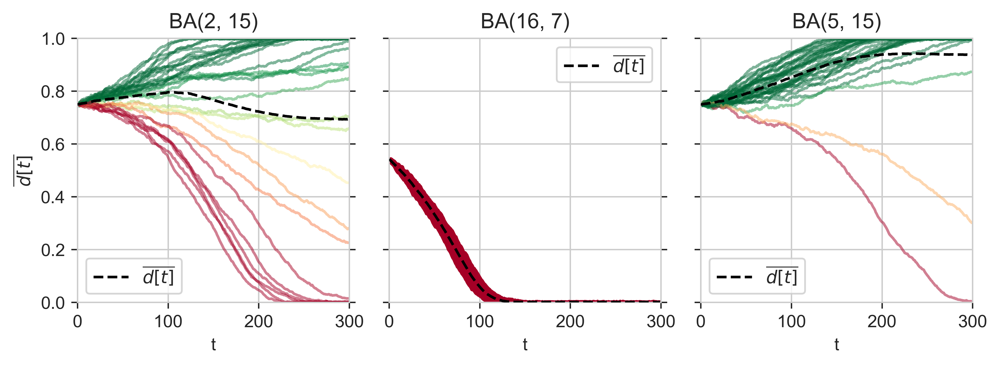

In [155]:
# PLOT TRAJECTORY

# DO 3 plots for same type of network
topology_plot = 'BA'
fig, axs = plt.subplots(1, 3, figsize=(8, 3), dpi=dpi,sharey=True)

c0 = (0.18195582, 0.11955283, 0.23136943)
c1 = (0.54578602, 0.8544913, 0.69848331)

# First subplot
regimes = [(2,15)]
colors = ['tab:blue']

for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'

    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean
    axs[0].plot(dev_t,ls='--',c='black',label='$\overline{d[t]}$',zorder=5,lw=1.5)

    # Plot all runs
    for r in range(R):
        last_m_value = np.mean(data['node_development'][r,T-1,:])
        c = plt.cm.RdYlGn(last_m_value)
        axs[0].plot(np.mean(data['node_development'][r,:,:],axis=1),c=c,alpha=0.5)

    axs[0].set_title(f'{topology_plot}{regime1}')

axs[0].set_xlim([0,T])
axs[0].set_ylim([0,1])
axs[0].set_xlabel('t')
axs[0].set_ylabel('$\overline{d[t]}$')
axs[0].legend()

# Second subplot
regimes = [(16,7)]

for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'
   
    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean
    axs[1].plot(dev_t,ls='--',c='black',label='$\overline{d[t]}$',zorder=5,lw=1.5)

    # Plot all runs
    for r in range(R):
        last_m_value = np.mean(data['node_development'][r,T-1,:])
        c = plt.cm.RdYlGn(last_m_value)
        axs[1].plot(np.mean(data['node_development'][r,:,:],axis=1),c=c,alpha=1)

    axs[1].set_title(f'{topology_plot}{regime1}')


axs[1].set_xlim([0,T])
axs[1].set_ylim([0,1])
axs[1].set_xlabel('t')
axs[1].legend()



# Third subplot
regimes = [(5,15)]

for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'
   
    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean    
    axs[2].plot(dev_t,ls='--',c='black',label='$\overline{d[t]}$',zorder=5,lw=1.5)

    # Plot all runs
    for r in range(R):
        last_m_value = np.mean(data['node_development'][r,T-1,:])
        c = plt.cm.RdYlGn(last_m_value)
        axs[2].plot(np.mean(data['node_development'][r,:,:],axis=1),c=c,alpha=0.5)

    axs[2].set_title(f'{topology_plot}{regime1}')

axs[2].set_xlim([0,T])
axs[2].set_ylim([0,1])
axs[2].set_xlabel('t')
axs[2].legend()

axs.flat[0].tick_params(left=True, bottom=True,right=True)
axs.flat[1].tick_params(left=True, bottom=True,right=True)
axs.flat[2].tick_params(left=True, bottom=True)

plt.tight_layout()
plt.savefig(f'{figures_path}/RESULT_ME_PATHS_ER.jpg', dpi=dpi)

___

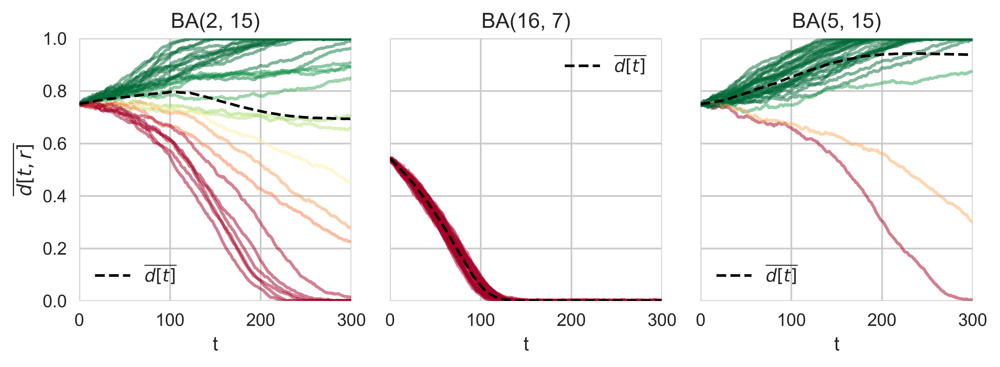

In [680]:
topology_plot = 'BA'
fig, axs = plt.subplots(1, 3, figsize=(8, 3), dpi=dpi,sharey=True)

# First subplot
regimes = [(2,15)]
colors = ['tab:blue']

for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'

    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean
    axs[0].plot(dev_t,ls='--',c='black',label='$\overline{d[t]}$',zorder=5,lw=1.5)

    # Plot all runs
    for r in range(R):
        last_m_value = np.mean(data['node_development'][r,T-1,:])
        axs[0].plot(np.mean(data['node_development'][r,:,:],axis=1),c=plt.cm.RdYlGn(last_m_value),alpha=0.5)

    axs[0].set_title(f'{topology_plot}{regime1}')

axs[0].set_xlim([0,T])
axs[0].set_ylim([0,1])
axs[0].set_xlabel('t')
axs[0].set_ylabel('$\overline{d[t,r]}$')
axs[0].legend()

# Second subplot
regimes = [(16,7)]

for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'
   
    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean
    axs[1].plot(dev_t,ls='--',c='black',label='$\overline{d[t]}$',zorder=5,lw=1.5)

    # Plot all runs
    for r in range(R):
        last_m_value = np.mean(data['node_development'][r,T-1,:])
        axs[1].plot(np.mean(data['node_development'][r,:,:],axis=1),c=plt.cm.RdYlGn(last_m_value),alpha=0.5)

    axs[1].set_title(f'{topology_plot}{regime1}')

axs[1].set_xlim([0,T])
axs[1].set_ylim([0,1])
axs[1].set_xlabel('t')
axs[1].legend()

# Third subplot
regimes = [(5,15)]

for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'
   
    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{regime1[0]}_{regime1[1]}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    dev_t = np.mean(data['node_development'],axis=(0,2))
    dev_tv = np.var(data['node_development'],axis=(0,2))

    # Plot the mean
    axs[2].plot(dev_t,ls='--',c='black',label='$\overline{d[t]}$',zorder=5,lw=1.5)

    # Plot all runs
    for r in range(R):
        last_m_value = np.mean(data['node_development'][r,T-1,:])
        axs[2].plot(np.mean(data['node_development'][r,:,:],axis=1),c=plt.cm.RdYlGn(last_m_value),alpha=0.5)

    axs[2].set_title(f'{topology_plot}{regime1}')

axs[2].set_xlim([0,T])
axs[2].set_ylim([0,1])
axs[2].set_xlabel('t')
axs[2].legend()

axs.flat[0].tick_params(left=True, bottom=True,right=True)
axs.flat[1].tick_params(left=True, bottom=True,right=True)
axs.flat[2].tick_params(left=True, bottom=True)

plt.tight_layout()
plt.savefig(f'{figures_path}/RESULT_ME_PATHS_BA.jpg', dpi=dpi)

___

## Mixed Equilibrium Networks

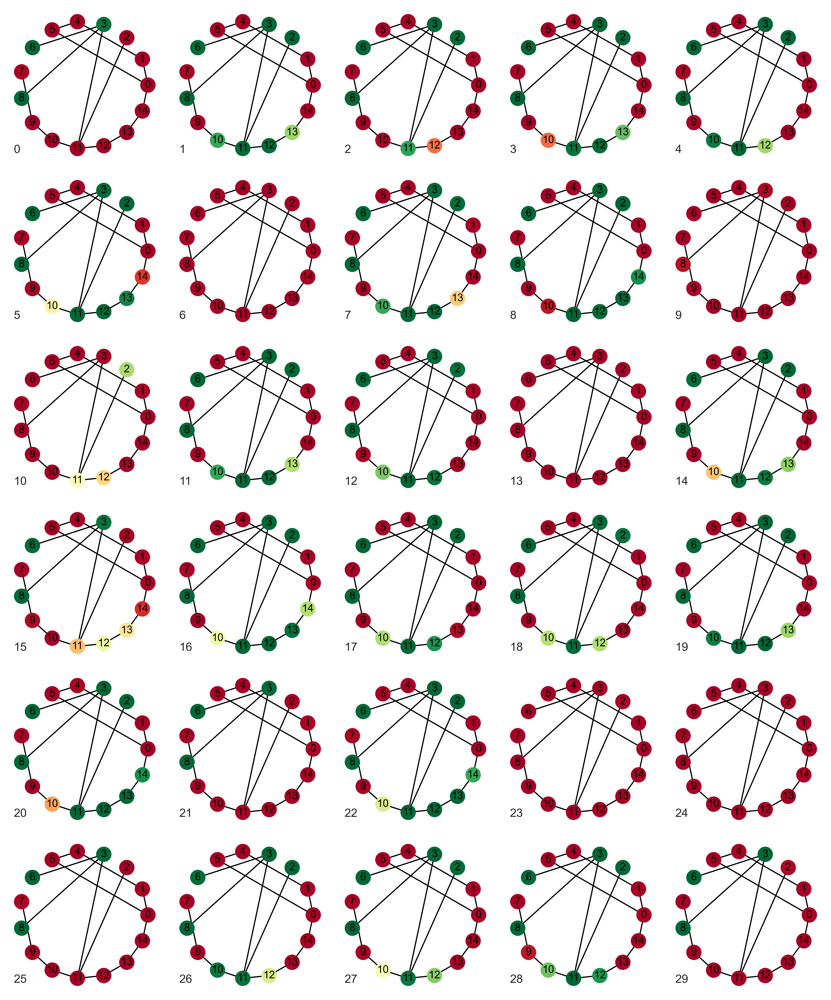

In [700]:
# PLOT ALL NETWORKS
dpi = 550

# Plot structure
num_rows = 5
num_cols = 4

i = 5
j = 15

# Retrieve data
for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'

    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{i}_{j}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    final_dev = data['node_development'][:,T-1,:]

# Create separate plots for each network type
for n_type in ['WS']:

    # Retrieve network!
    this_network = network_topologies[n_type][i]

    # Convert it to networkx object
    this_network = nx.from_numpy_array(this_network)

    # Create a figure with subplots
    fig, axs = plt.subplots(6, 5, figsize=(10, 12),sharex=True,sharey=True,dpi=dpi)

    # Fill it!
    for i in range(30):
        # Plot it    
        pos = nx.circular_layout(this_network)
        node_colors = plt.cm.RdYlGn(final_dev[i,:])
        nx.draw_networkx(this_network, 
                        ax=axs.flat[i], 
                        pos=pos, 
                        with_labels=True, 
                        node_color=node_colors,
                        node_size=160,
                        font_size=9,
                        linewidths=0.5)

        axs.flat[i].grid(False)
        axs.flat[i].text(-1.1, -1.1, f'{i}', ha='left', va='bottom', fontsize=10)

# Save the plot
plt.tight_layout()
plt.savefig(f'{figures_path}/RESULT_PATHS_RUN_ER_{i}_{j}.jpg', dpi=dpi)

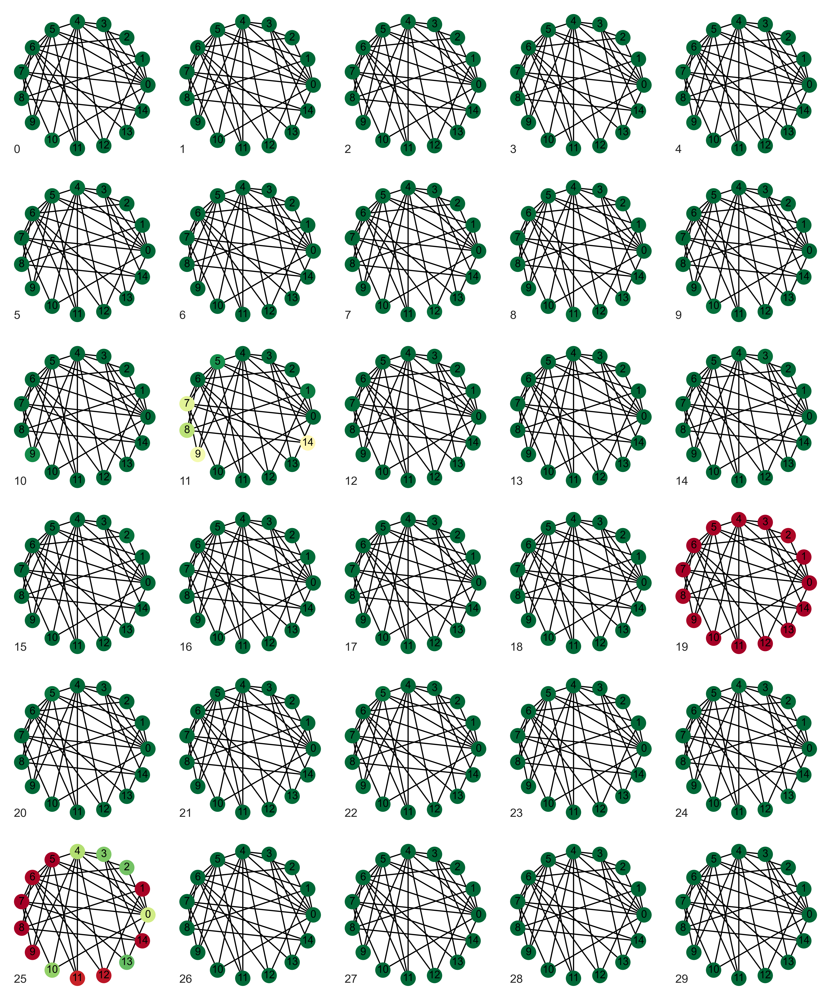

In [712]:
# PLOT ALL NETWORKS
dpi = 550

# Plot structure
num_rows = 5
num_cols = 4

i = 5
j = 15

topology_plot = 'BA'

# Retrieve data
for index in range(len(regimes)):
    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'
    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{i}_{j}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    final_dev = data['node_development'][:,T-1,:]

# Create separate plots for each network type
for n_type in ['BA']:

    # Retrieve network!
    this_network = network_topologies[n_type][i]
    # Convert it to networkx object
    this_network = nx.from_numpy_array(this_network)
    # Create a figure with subplots
    fig, axs = plt.subplots(6, 5, figsize=(10, 12),sharex=True,sharey=True,dpi=dpi)

    # Fill it!
    for i in range(30):
        # Plot it    
        pos = nx.circular_layout(this_network)
        node_colors = plt.cm.RdYlGn(final_dev[i,:])
        nx.draw_networkx(this_network, 
                        ax=axs.flat[i], 
                        pos=pos, 
                        with_labels=True, 
                        node_color=node_colors,
                        node_size=160,
                        font_size=9,
                        linewidths=0.5)

        axs.flat[i].grid(False)
        axs.flat[i].text(-1.1, -1.1, f'{i}', ha='left', va='bottom', fontsize=10)

# Save the plot
plt.tight_layout()
plt.savefig(f'{figures_path}/RESULT_PATHS_RUN_BA_{i}_{j}.jpg', dpi=dpi)

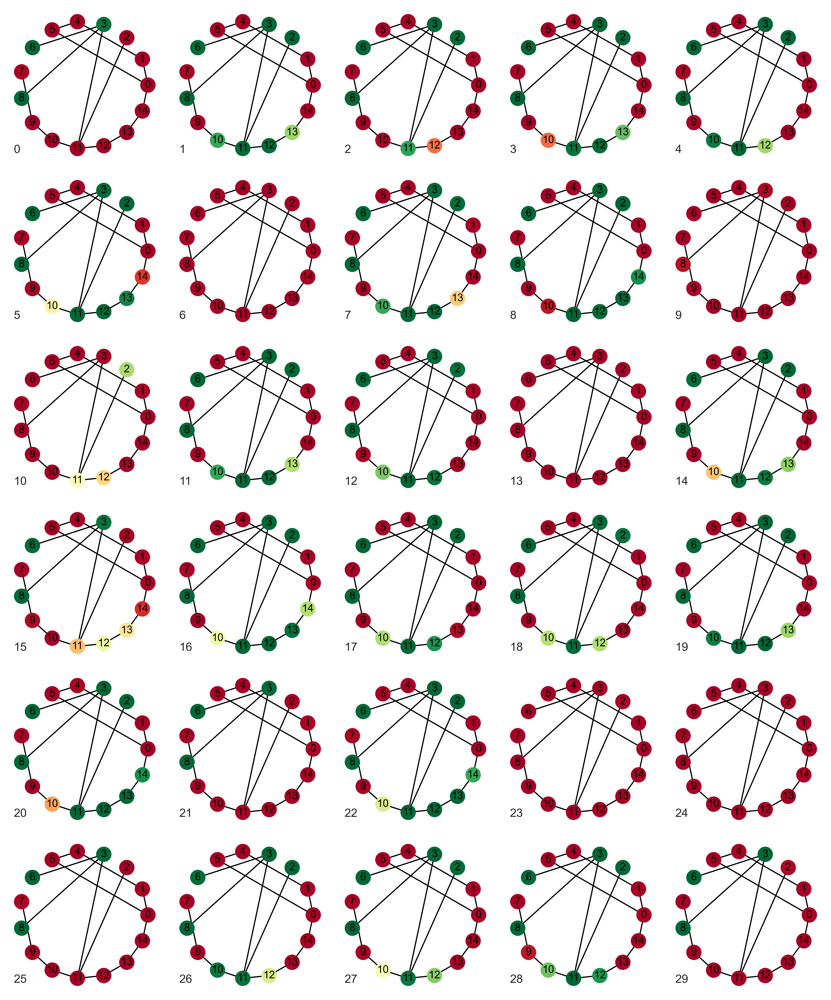

In [711]:
# PLOT ALL NETWORKS
dpi = 550

# Plot structure
num_rows = 5
num_cols = 4

i = 5
j = 15

topology_plot = 'WS'

# Retrieve data
for index in range(len(regimes)):

    regime1 = regimes[index]
    distribution_plot = 'Beta_v0.01'

    results_distribution_path = results_path +'/' + topology_plot + '/' + distribution_plot
    result_path = results_distribution_path + '/' + f'{i}_{j}.pickle'

    # Retrieve result
    with open(result_path, 'rb') as h:
        data = pickle.load(h)

    final_dev = data['node_development'][:,T-1,:]

# Create separate plots for each network type
for n_type in ['WS']:

    # Retrieve network!
    this_network = network_topologies[n_type][i]

    # Convert it to networkx object
    this_network = nx.from_numpy_array(this_network)

    # Create a figure with subplots
    fig, axs = plt.subplots(6, 5, figsize=(10, 12),sharex=True,sharey=True,dpi=dpi)

    # Fill it!
    for i in range(30):
        # Plot it    
        pos = nx.circular_layout(this_network)
        node_colors = plt.cm.RdYlGn(final_dev[i,:])
        nx.draw_networkx(this_network, 
                        ax=axs.flat[i], 
                        pos=pos, 
                        with_labels=True, 
                        node_color=node_colors,
                        node_size=160,
                        font_size=9,
                        linewidths=0.5)

        axs.flat[i].grid(False)
        axs.flat[i].text(-1.1, -1.1, f'{i}', ha='left', va='bottom', fontsize=10)

# Save the plot
plt.tight_layout()
plt.savefig(f'{figures_path}/RESULT_PATHS_RUN_WS_{i}_{j}.jpg', dpi=dpi)

___